<div style="background-color: #FFFFCC; padding: 30px">
<center><h1 style="color:#333335; font-size: 300%">Fourier II (Filtering and Convolution)</h1></center>
<center><h1 style="color:#333333">Sean Wade</h1></center>
</div>

In [2]:
import numpy as np
import scipy as sp
import scipy.fftpack as fftpack
from scipy.io import wavfile
import IPython.display as play
from matplotlib import pyplot as plt
import cmath
import wave

In [3]:
%matplotlib inline
%qtconsole

The *Signal* class is for conviniace of working with the samples and ploting them

In [4]:
class Signal(object):
    def __init__(self, sample_rate, sample_array):
        """Initialize the a object of type Signal with its sample_rate and sample_array
        """ 
        self.rate = sample_rate
        self.signal = sample_array
        self.dtf = self.calculate_DFT()
    
    def __add__(self, other):
        if self.rate != other.rate:
            raise ValueError("The sample rates are not the same.")
        new_signal = self.signal + other.signal
        return Signal(self.rate, new_signal)
    
    def plot(self, DFT=False):
        if DFT is True:
            self.calculate_DFT()
            x_vals = np.arange(1, len(self.dft)+1, 1) * 1.
            x_vals = x_vals / len(self.signal)
            x_vals = x_vals * self.rate
            plt.plot(x_vals, np.abs(self.dft))
        else:
            plt.plot(self.signal)
        
        
    def write_to_file(self, filename):
        wavfile.write(filename, self.rate, self.signal)
        
    def calculate_DFT(self):
        self.dft = fftpack.fft(self.signal)

<div style="background-color: #E3F8FA; width: 100%; padding:30px; border">
<b><span style="color:#04353B; font-size:150%; font-family:Maraco">Cleaning up a Noisy Signal</span></b>
<p style="line-height: 20px">Below is a sample .wav file of a person speaking that is unrecognizable because of backgound noise.  If we plot the soundwave it is a big mess and we cant see anything.</p>
</div>

In [5]:
play.Audio('Noisysignal1.wav')

In [6]:
play.Audio('Noisysignal2.wav')

<div style="background-color: #E3F8FA; width: 100%; padding:30px; border">
<p style="line-height: 20px">
However, if we take the Fourier transform of the signal we can see that the static is the result of some concentrated high frequency niose.  This noise can be removed by setting the coefficients of the highg frequncies to zero.  Taking the inverse Fourier brings us back with a clean signal.
</p>
</div>

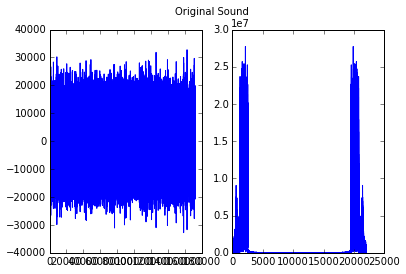

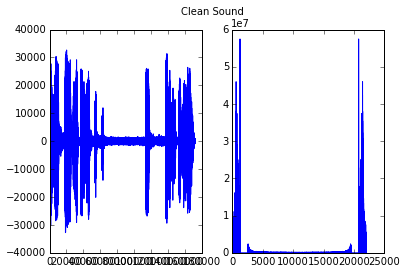

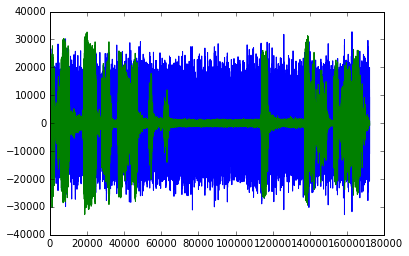

In [7]:
# Load the noisy .wav file
rate, signal = wavfile.read('Noisysignal1.wav')
bad_signal = Signal(rate, signal)

# Plot the original sound and its FFT
plt.figure(1).suptitle("Original Sound")
plt.subplot(121)
bad_signal.plot()
plt.subplot(122)
bad_signal.plot(True)
plt.show()

# Cut out all the bad frequencies from the FFT
fsig = sp.fft(bad_signal.signal, axis=0)
for j in xrange(10000, 20000):
    fsig[j] = 0
    fsig[-j] = 0

# inverse FFT back and scale
newsig = sp.ifft(fsig)
newsig = sp.real(newsig)
newsig = sp.int16(newsig / sp.absolute(newsig).max() * 32767)
clean_signal = Signal(rate, newsig)

# Plot the clean sound and its FFT
plt.figure(2).suptitle("Clean Sound")
plt.subplot(121)
clean_signal.plot(False)
plt.subplot(122)
clean_signal.plot(True)
plt.show()

bad_signal.plot()
clean_signal.plot()
plt.show()

clean_signal.write_to_file("clean_1.wav")
play.Audio('clean_1.wav')

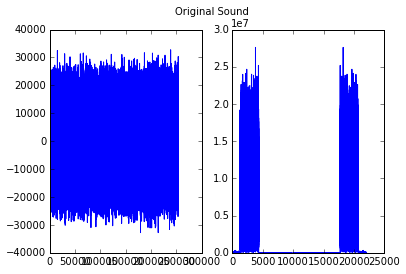

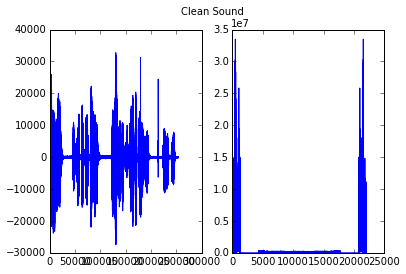

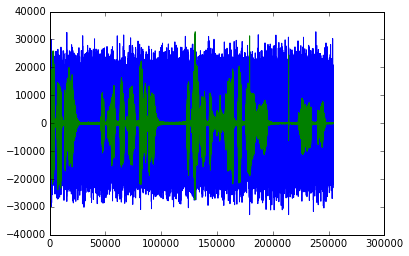

In [8]:
# Load the noisy .wav file
rate, signal = wavfile.read('Noisysignal2.wav')
bad_signal = Signal(rate, signal)

# Plot the original sound and its FFT
plt.figure(1).suptitle("Original Sound")
plt.subplot(121)
bad_signal.plot()
plt.subplot(122)
bad_signal.plot(True)
plt.show()

# Cut out all the bad frequencies from the FFT
fsig = sp.fft(bad_signal.signal, axis=0)
for j in xrange(14999, 50000):
    fsig[j] = 0
    fsig[-j] = 0

# inverse FFT back and scale
newsig = sp.ifft(fsig)
newsig = sp.real(newsig)
newsig = sp.int16(newsig / sp.absolute(newsig).max() * 32767)
clean_signal = Signal(rate, newsig)

# Plot the clean sound and its FFT
plt.figure(2).suptitle("Clean Sound")
plt.subplot(121)
clean_signal.plot(False)
plt.subplot(122)
clean_signal.plot(True)
plt.show()

bad_signal.plot()
clean_signal.plot()
plt.show()

clean_signal.write_to_file("clean_2.wav")
play.Audio('clean_2.wav')

<div style="background-color: #E3F8FA; width: 100%; padding:30px; border">
<b><span style="color:#04353B; font-size:150%; font-family:Maraco">Filtering and Convolution</span></b>
<p style="line-height: 20px">
The DFT can be used for mmore than just filtering out signal noise.  Another aplication is using it to determine the acoustics of a room and generate an approximation of how something, like a grand piano, will sound in the bathroom.
</p>
<p style="margin-top: 2cm">
To do this we will use the idea of convolution of signals.  This is essiantally a way of mixing the signals and has the fast equation: 
$$\mathscr{F}(\: f*g) = \mathscr{F}(\: f \:) \odot \mathscr{F}(\: g \:)$$
</p>
</div>

In [9]:
play.Audio('balloon.wav')

In [10]:
play.Audio('chopin_full.wav')

## Convolve the Signals

In [ ]:
input_rate, input_signal = wavfile.read('chopin_full.wav')
ballon_rate, ballon_signal = wavfile.read('balloon.wav')
input_signal_zeros = np.hstack((input_signal[:,1], np.zeros(5*44100)))
full_signal_len = len(input_signal_zeros)
num_of_zeros_for_ballon = full_signal_len - len(ballon_signal)
ballon_middle = len(ballon_signal) / 2
balloon_signal_zeros = np.hstack([ballon_signal[:ballon_middle,1], np.zeros((num_of_zeros_for_ballon)), ballon_signal[ballon_middle:, 1]])
full_balloon = balloon_signal_zeros
full_chopin = input_signal_zeros
fourier_convolution = np.multiply(sp.fft(full_chopin), sp.fft(full_balloon))
result = sp.ifft(fourier_convolution)
result = sp.real(result)
result = sp.int16(result / sp.absolute(result).max() * 32767)
final = Signal(input_rate, result.real)
final.write_to_file('acoutstic_chopin_mono.wav')

### The result is how Chopin would sound in the hall where the balloon was popped

In [ ]:
play.Audio('acoustic_chopin_mono.wav')